### Laboratorium 5 - część badawcza

W pakiecie OpenCV wszystkie zadania związane z detekcją i opisem punktów kluczowych realizowane są przez zestaw specjalnych klas, dla których bazową jest `cv::Feature2D`. Jedną z wielu pochodnych tej klasy jest interesująca nas na zajęciach `cv::SIFT`, z której dokumentacją należy się zapoznać.  
Najważniejsze, co trzeba wiedzieć:
1. do konstrukcji obiektu SIFT służy metoda [`cv2.SIFT_create`](https://docs.opencv.org/4.x/d7/d60/classcv_1_1SIFT.html#ad337517bfdc068ae0ba0924ff1661131) - to do niej przekazujemy parametry detektora (w dokumentacji występuje jako `cv::SIFT::create`);
2. obsługujemy detektor przez interfejs `cv::Feature2D`, konkretnie metody [`detect`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#aa4e9a7082ec61ebc108806704fbd7887) do detekcji punktów kluczowych oraz [`compute`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#ab3cce8d56f4fc5e1d530b5931e1e8dc0) do obliczania ich deskryptorów (opcjonalnie `detectAndCompute`).

Schemat użycia:
```python
sift_instance = cv2.SIFT_create()
# 'image' powinno być obrazem jednokanałowym (jeśli nie, zostanie zastosowane cvtColor z flagą COLOR_BGR2GRAY)
keypoints = sift_instance.detect(image)
keypoints, descriptors = sift_instance.compute(image, keypoints)
```

`keypoints` jest listą obiektów specjalnego typu `cv2.KeyPoint`, która **jest modyfikowana** przez `SIFT::compute`!  
`descriptors` jest natomiast macierzą float32 o wymiarach NxK, gdzie N jest liczbą punktów kluczowych, a K jest liczbą obliczonych cech.

Warto również zapoznać się z funkcją [`cv2.drawKeypoints`](https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920) w kontekście prezentacji wyników. Zwróć uwagę na flagi sterujące rysowaniem - szczególnie użyteczna jest `cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [2]:
from lab5.research_utils import (
    analyze_sift_params,
    match_and_analyze_sift,
    locate_object_with_homography,
)

#### Zadanie 1

Przetestuj wpływ podstawowych parametrów detektora SIFT (`contrastThreshold` i `edgeThreshold`) na uzyskiwane punkty kluczowe (liczność, lokalizacja, rozmiar), korzystając z obrazów `cells` i `lena`. Pamiętaj że ich działanie jest odwrotne (tzn. jeden odsiewa cechy "mniejsze niż", a drugi "większe niż").

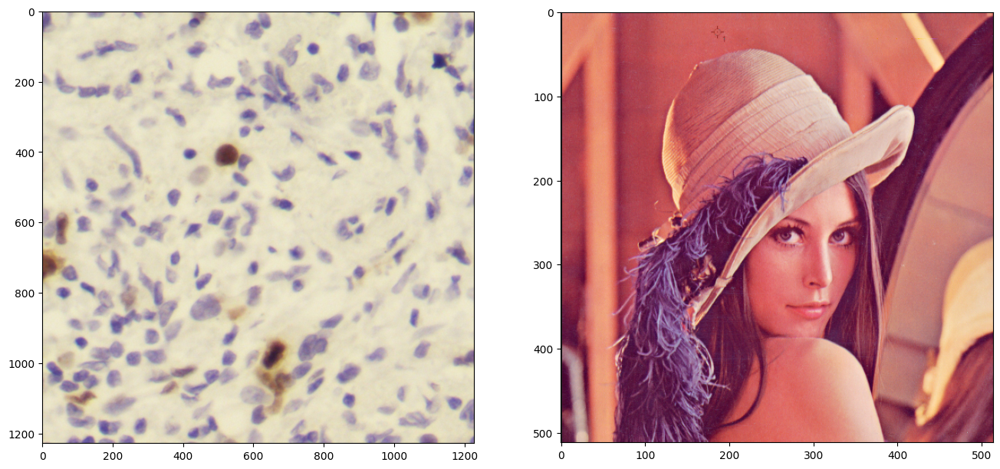

In [3]:
cells: np.ndarray = cv2.imread("lab5/dane/p1_0308_7.jpg")
lena: np.ndarray = cv2.imread("lab5/dane/Lena.jpg")
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(cells[..., ::-1])
a2.imshow(lena[..., ::-1]);

**contrastThreshold** - The contrast threshold used to filter out weak features in semi-uniform (low-contrast) regions. The larger the threshold, the less features are produced by the detector.

**Note**
The contrast threshold will be divided by nOctaveLayers when the filtering is applied. When nOctaveLayers is set to default and if you want to use the value used in D. Lowe paper, 0.03, set this argument to 0.09.

**nOctaveLayers** - The number of layers in each octave. 3 is the value used in D. Lowe paper. The number of octaves is computed automatically from the image resolution.


**edgeThreshold** - The threshold used to filter out edge-like features. Note that the its meaning is different from the contrastThreshold, i.e. the larger the edgeThreshold, the less features are filtered out (more features are retained).

wartości default

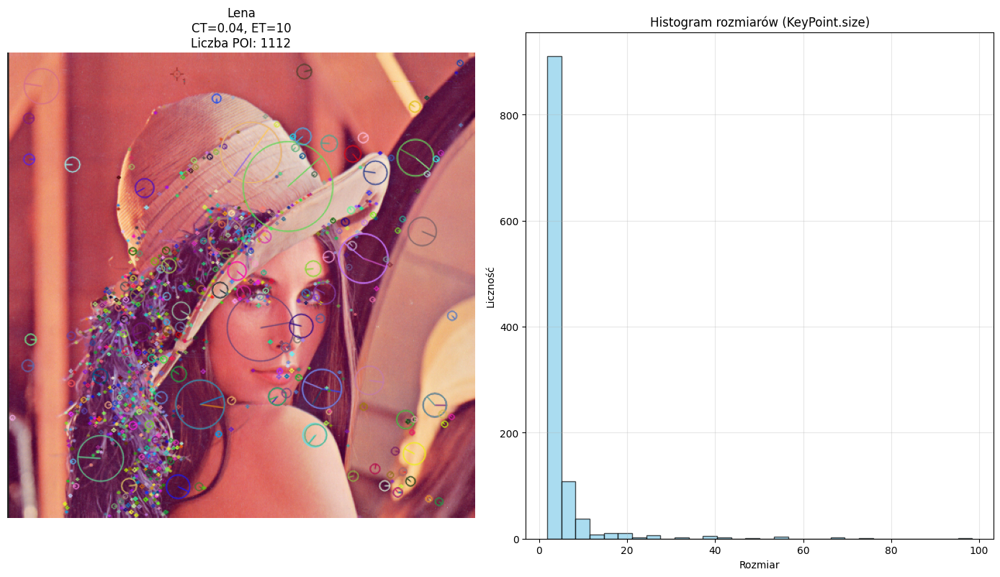

In [4]:
analyze_sift_params(lena, contrast_th=0.04, edge_th=10, title_prefix="Lena")

wpierw analiza `constrast_th` dla stałego, `edge_th`

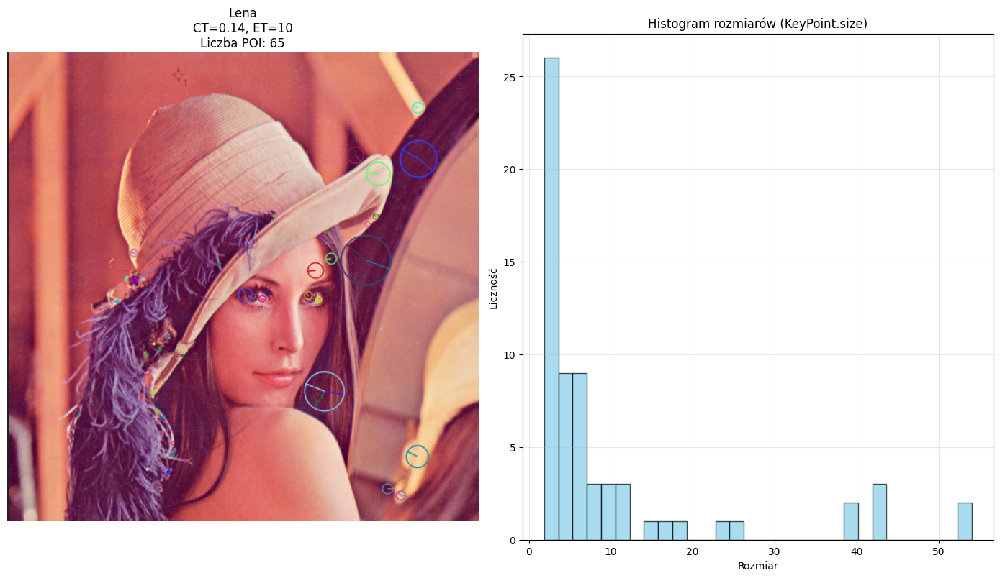

In [5]:
analyze_sift_params(lena, contrast_th=0.14, edge_th=10, title_prefix="Lena")

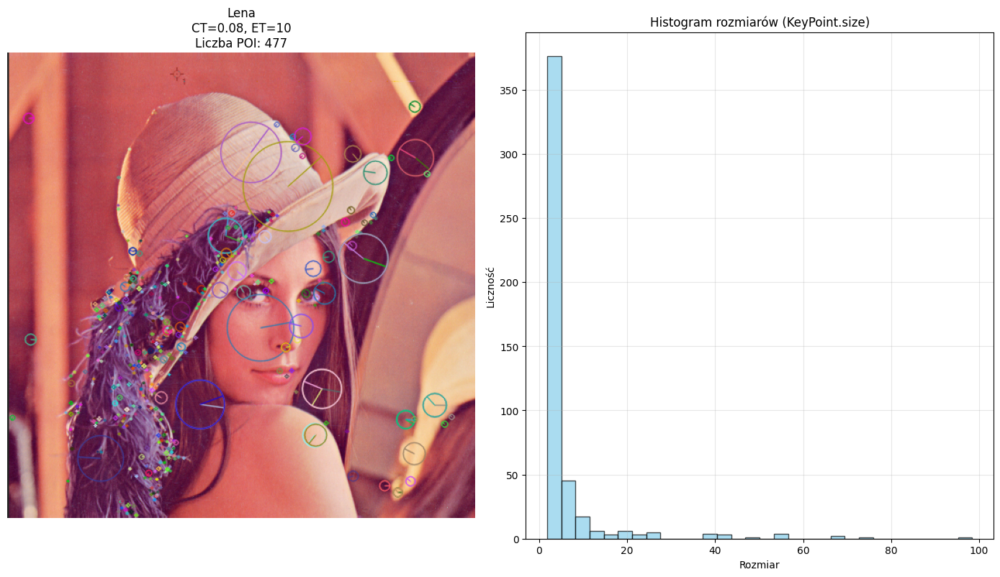

In [6]:
analyze_sift_params(lena, contrast_th=0.08, edge_th=10, title_prefix="Lena")

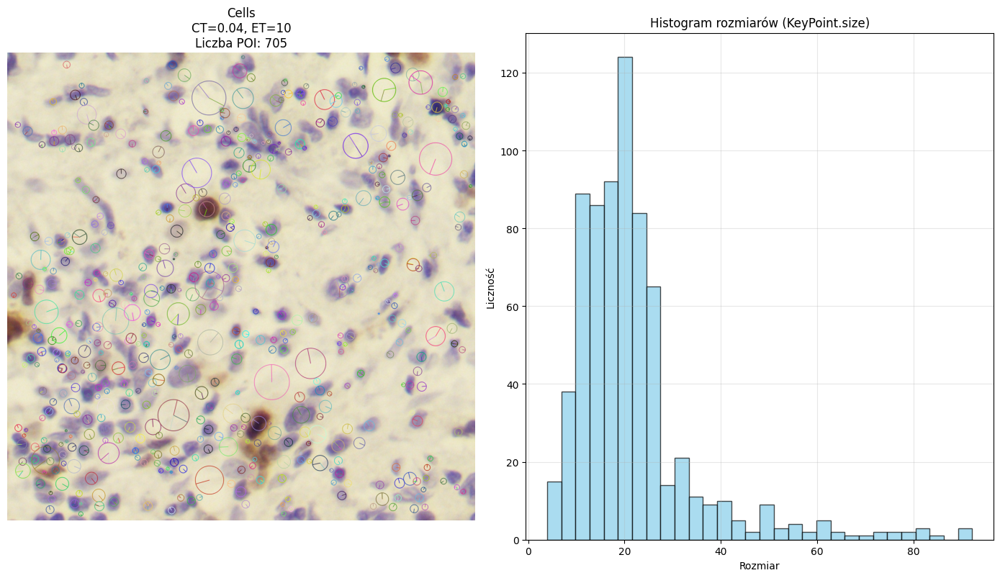

In [9]:
analyze_sift_params(cells, contrast_th=0.04, edge_th=10, title_prefix="Cells")

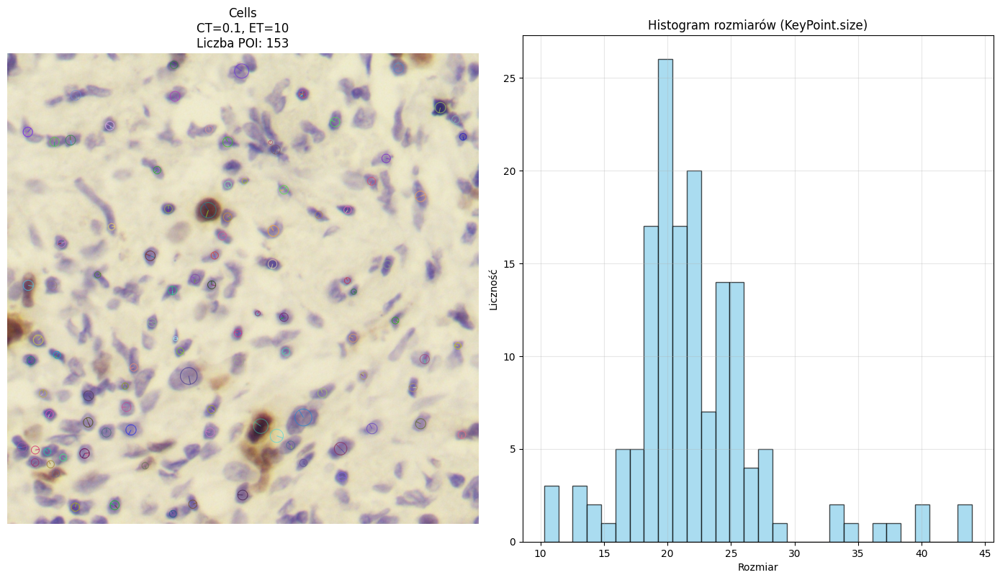

In [10]:
analyze_sift_params(cells, contrast_th=0.1, edge_th=10, title_prefix="Cells")

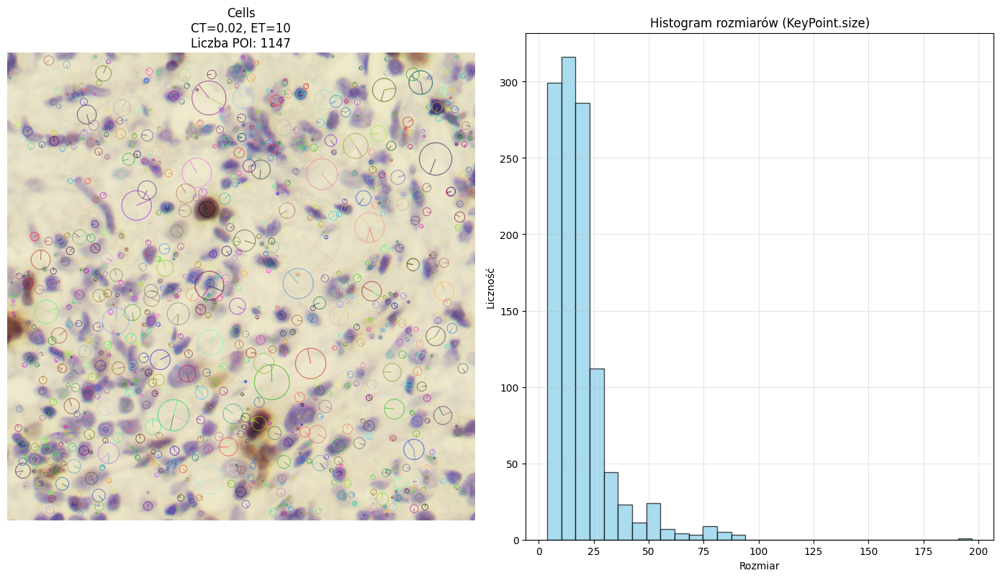

In [11]:
analyze_sift_params(cells, contrast_th=0.02, edge_th=10, title_prefix="Cells")

#### Zadanie 2

Detektor SIFT jest w teorii niezmienniczy względem translacji, rotacji czy zmiany skali. Przetestuj te własności w praktyce, sprawdzając stabilność punktów wykrywanych na obróconej i przeskalowanej wersji obrazów `cells` i `lena`. Dokonaj oceny wizualnie, sprawdzając zachowanie detektora dla kilku wybranych rotacji i skal (**nie** grid search).

_Co świadczy o stabilności i niezmienniczości detektora (lub ich braku)?_

In [14]:
def rotate(image: np.ndarray, angle: float, scale: float = 1.0) -> np.ndarray:
    center = (image.shape[0] // 2, image.shape[1] // 2)
    rmat = cv2.getRotationMatrix2D(center, angle, scale)
    return cv2.warpAffine(
        image, rmat, (image.shape[0], image.shape[1]), flags=cv2.INTER_CUBIC
    )

In [15]:
SIFT_PARAMS = {"contrastThreshold": 0.08, "edgeThreshold": 5}

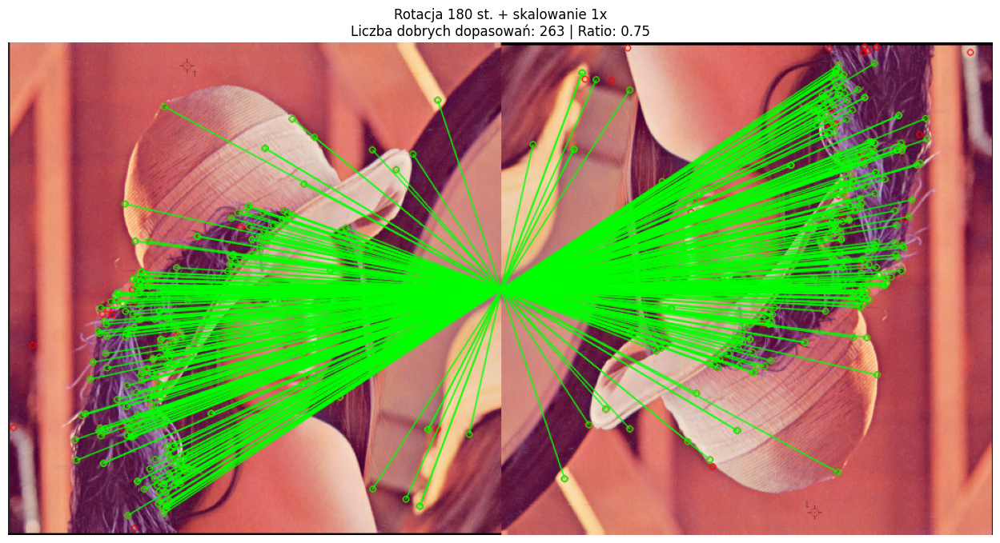

In [16]:
ROTATION_ANGLE = 180
SCALE = 1
lena_rot = rotate(lena, ROTATION_ANGLE, scale=SCALE)
_ = match_and_analyze_sift(
    lena,
    lena_rot,
    sift_params=SIFT_PARAMS,
    title=f"Rotacja {ROTATION_ANGLE} st. + skalowanie {SCALE}x",
    ratio_thresh=0.75,
    knn=2,
)

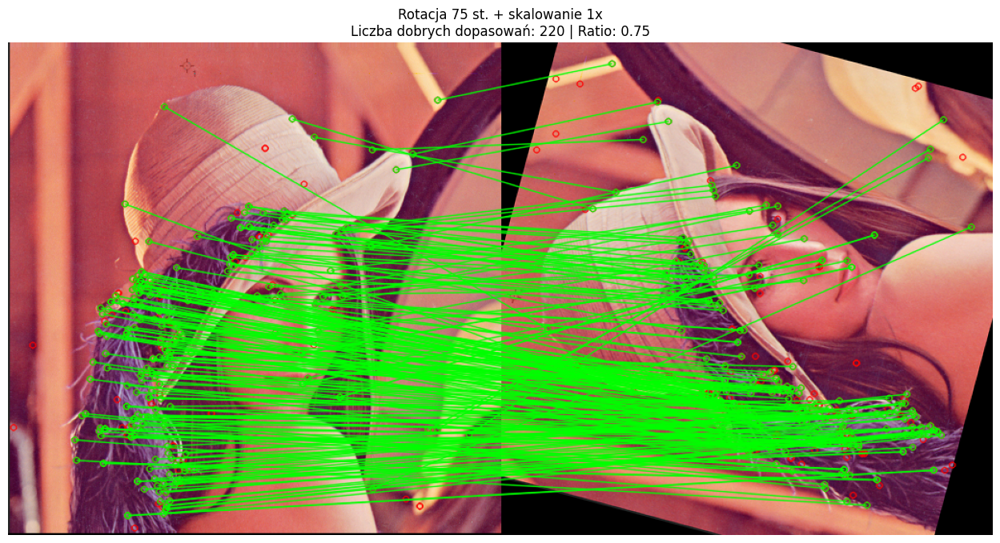

In [17]:
ROTATION_ANGLE = 75
SCALE = 1
lena_rot = rotate(lena, ROTATION_ANGLE, scale=SCALE)
_ = match_and_analyze_sift(
    lena,
    lena_rot,
    sift_params={"contrastThreshold": 0.08, "edgeThreshold": 5},
    title=f"Rotacja {ROTATION_ANGLE} st. + skalowanie {SCALE}x",
    ratio_thresh=0.75,
    knn=2,
)

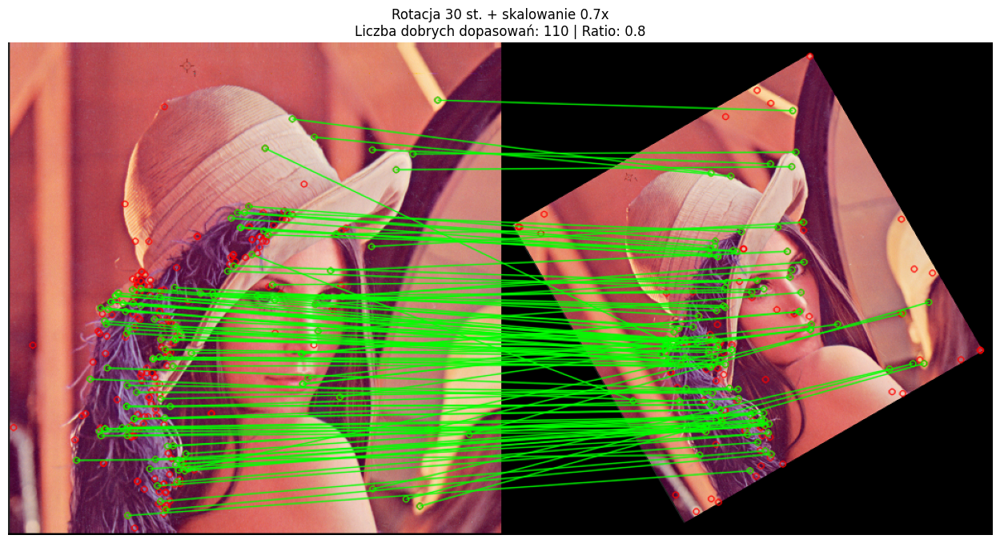

In [19]:
ROTATION_ANGLE = 30
SCALE = 0.7
lena_rot = rotate(lena, ROTATION_ANGLE, scale=SCALE)
_ = match_and_analyze_sift(
    lena,
    lena_rot,
    sift_params=SIFT_PARAMS,
    title=f"Rotacja {ROTATION_ANGLE} st. + skalowanie {SCALE}x",
    ratio_thresh=0.8,
    knn=2,
)

In [20]:
SIFT_PARAMS = {"contrastThreshold": 0.08, "edgeThreshold": 5}

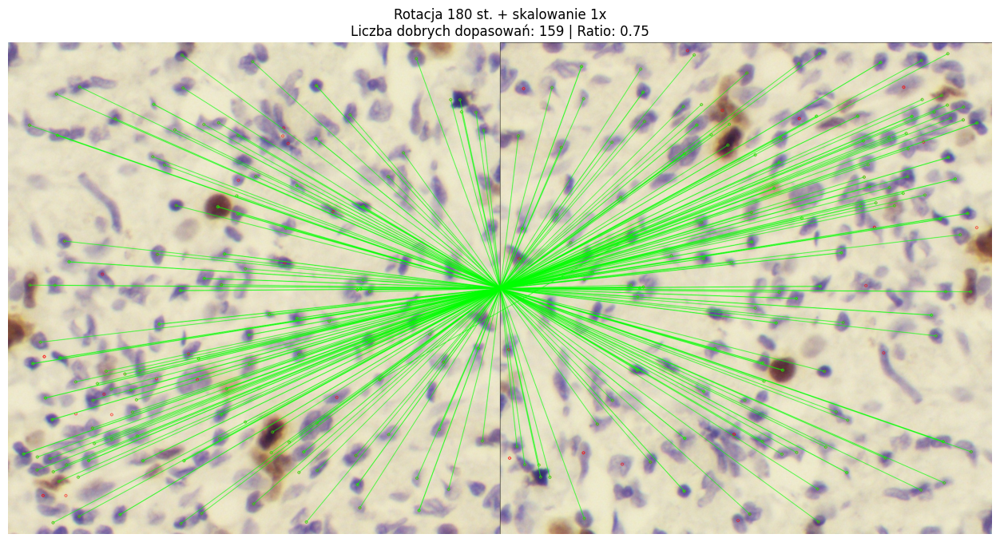

In [21]:
ROTATION_ANGLE = 180
SCALE = 1
cells_rot = rotate(cells, ROTATION_ANGLE, scale=SCALE)
_ = match_and_analyze_sift(
    cells,
    cells_rot,
    sift_params=SIFT_PARAMS,
    title=f"Rotacja {ROTATION_ANGLE} st. + skalowanie {SCALE}x",
    ratio_thresh=0.75,
    knn=2,
)

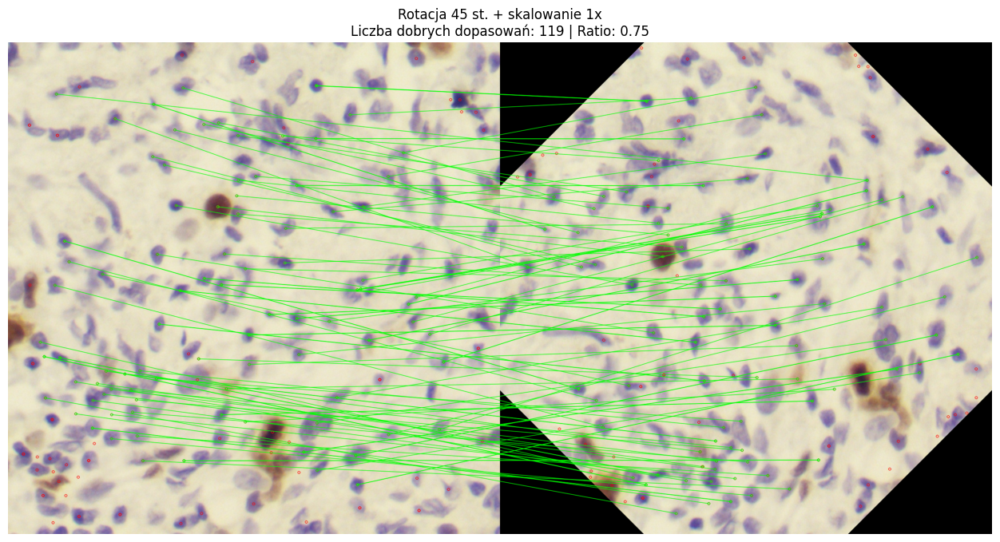

In [22]:
ROTATION_ANGLE = 45
SCALE = 1
cells_rot = rotate(cells, ROTATION_ANGLE, scale=SCALE)
_ = match_and_analyze_sift(
    cells,
    cells_rot,
    sift_params=SIFT_PARAMS,
    title=f"Rotacja {ROTATION_ANGLE} st. + skalowanie {SCALE}x",
    ratio_thresh=0.75,
    knn=2,
)

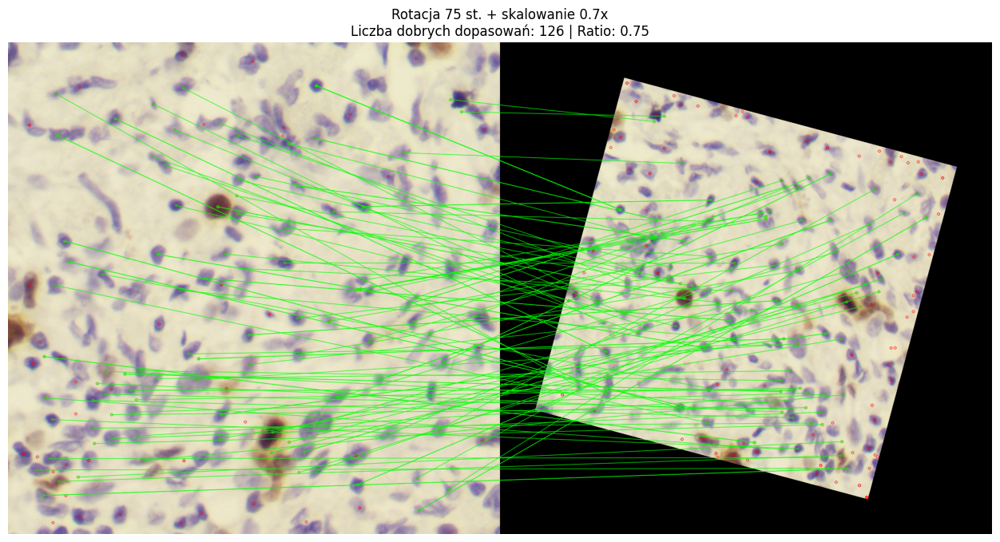

In [24]:
ROTATION_ANGLE = 75
SCALE = 0.7
cells_rot = rotate(cells, ROTATION_ANGLE, scale=SCALE)
_ = match_and_analyze_sift(
    cells,
    cells_rot,
    sift_params=SIFT_PARAMS,
    title=f"Rotacja {ROTATION_ANGLE} st. + skalowanie {SCALE}x",
    ratio_thresh=0.75,
    knn=2,
)

#### Zadanie 3

Dane są obrazy `coke` i `table`. Wykorzystaj metodologię parowania punktów kluczowych do znalezienia wystąpienia puszki z Colą na stole. To zadanie jest podzielone na dwie części - czytaj dalej.

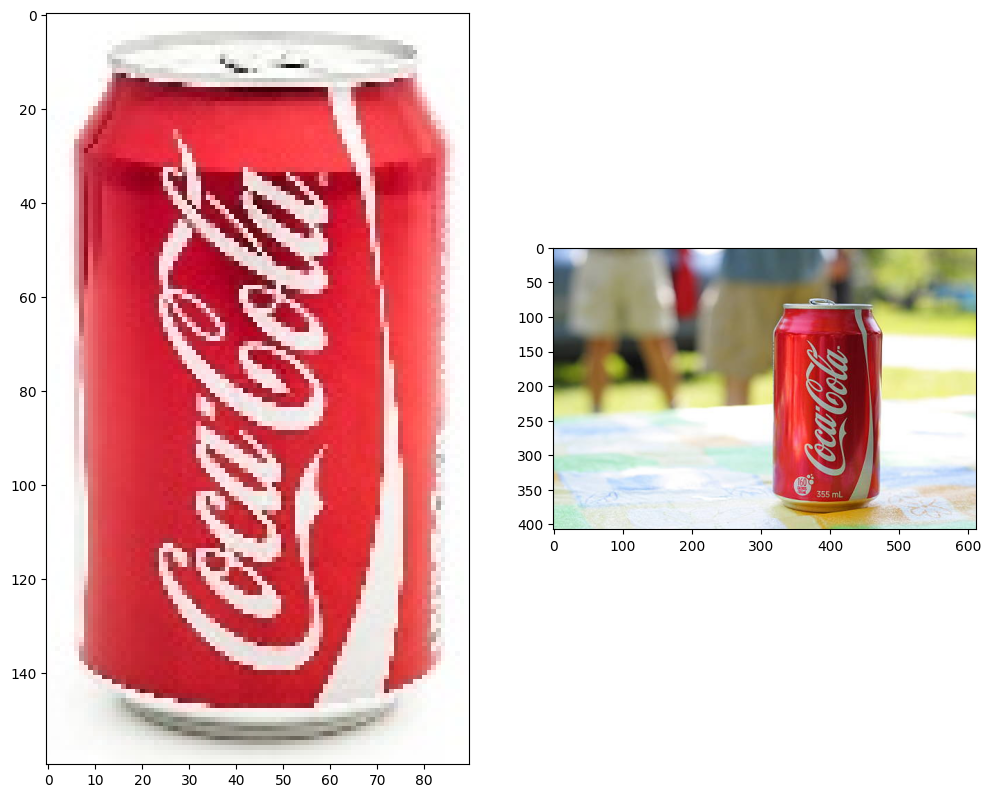

In [25]:
coke: np.ndarray = cv2.imread("lab5/dane/coke.jpg")
table: np.ndarray = cv2.imread("lab5/dane/coke-table.jpg")
f, (a1, a2) = plt.subplots(1, 2, figsize=(12, 12))
coke_crop = coke[20:180, 55:145, :]
a1.imshow(coke_crop[..., ::-1])
a2.imshow(table[..., ::-1]);

##### Zadanie 3a

Wykonaj detekcję punktów kluczowych i ich parowanie z użyciem dowolnego matchera. Wykonaj filtrację znalezionych par po dystansie - co obserwujesz, zmieniając próg?

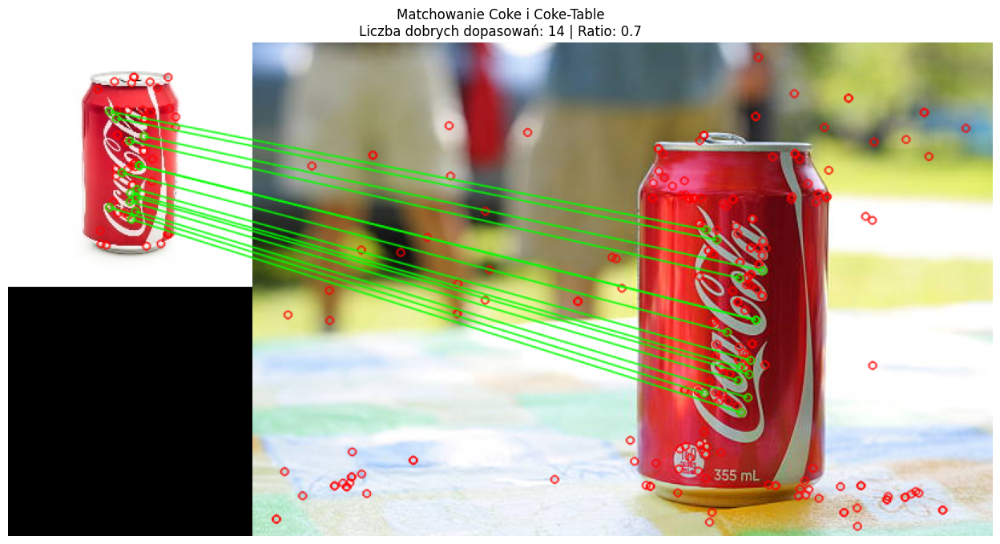

In [26]:
kp_c, kp_t, good_matches = match_and_analyze_sift(
    coke,
    table,
    sift_params={"contrastThreshold": 0.03, "edgeThreshold": 5},
    title="Matchowanie Coke i Coke-Table",
    ratio_thresh=0.70,
    knn=2,
)

https://docs.opencv.org/3.4/d4/de0/classcv_1_1DMatch.html

In [28]:
print(
    {
        "distance": good_matches[0].distance,
        "imgIdx": good_matches[0].imgIdx,
        "queryIdx": good_matches[0].queryIdx,
        "trainIdx": good_matches[0].trainIdx,
    }
)

{'distance': 186.74313354492188, 'imgIdx': 0, 'queryIdx': 5, 'trainIdx': 71}


https://docs.opencv.org/3.4/d2/d29/classcv_1_1KeyPoint.html

In [29]:
ex_kp_c = kp_c[good_matches[0].queryIdx]
print(
    {
        "angle": ex_kp_c.angle,
        "size": ex_kp_c.size,
        "pt": ex_kp_c.pt,
        "octave": ex_kp_c.octave,
        "class_id": ex_kp_c.class_id,
        "response": ex_kp_c.response,
    }
)

{'angle': 356.79266357421875, 'size': 2.040120840072632, 'pt': (28.505138397216797, 36.52812194824219), 'octave': 9241087, 'class_id': -1, 'response': 0.08860268443822861}


In [30]:
ex_kp_t = kp_t[good_matches[0].trainIdx]
print(
    {
        "angle": ex_kp_t.angle,
        "size": ex_kp_t.size,
        "pt": ex_kp_t.pt,
        "octave": ex_kp_t.octave,
        "class_id": ex_kp_t.class_id,
        "response": ex_kp_t.response,
    }
)

{'angle': 345.27490234375, 'size': 3.136080741882324, 'pt': (374.5700988769531, 154.5203094482422), 'octave': 6882303, 'class_id': -1, 'response': 0.0550113208591938}


##### Zadanie 3b

Znajdź transformację geometryczną dla par dopasowanych punktów, tak aby przekształcić `coke` (_train_) do geometrii `table` (_query_). Zademonstruj poprawność, zestawiając obok siebie przekształconą wersję `coke` oraz oryginalny `table`, bądź nanosząc jedno na drugie. Zidentyfikuj punkty, które znaleziona transformacja przekształca "dobrze", tzn. ich współrzędne po przekształceniu leżą w pobliżu odpowiadających im punktów z drugiego obrazu; nanieś je na obraz.

*Jak na wyniki wpływa wykrycie większej lub mniejszej liczby punktów kluczowych na etapie SIFT? W jakim stopniu filtracja poprawia rezultaty? Jak działa i jaką rolę w procesie parowania odgrywa RANSAC?*

https://docs.opencv.org/4.x/d9/d0c/group__calib3d.html#ga4abc2ece9fab9398f2e560d53c8c9780

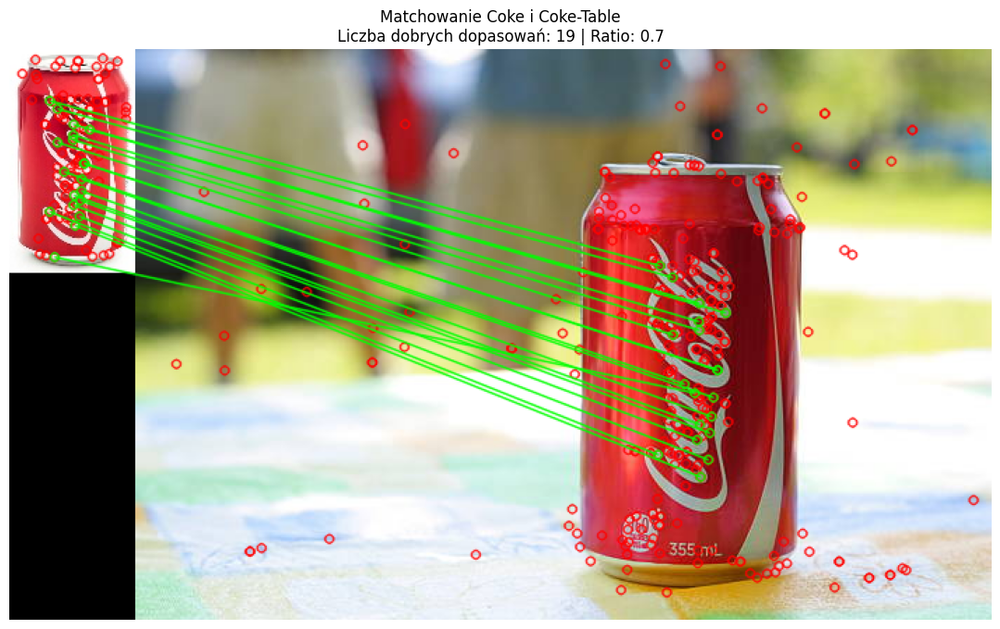

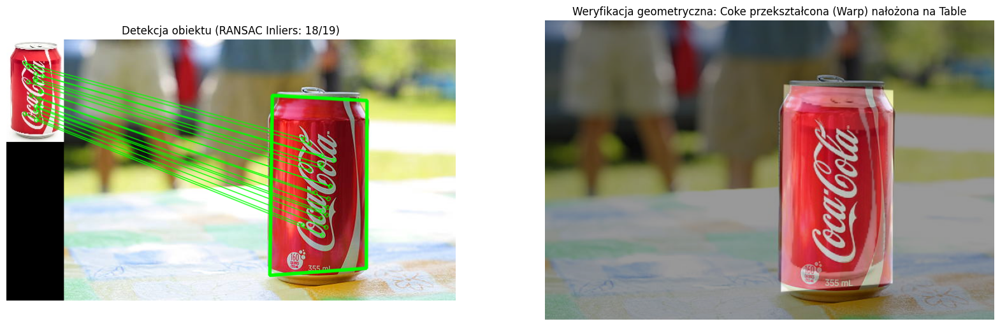

In [31]:
kp_c, kp_t, good_matches = match_and_analyze_sift(
    coke_crop,
    table,
    sift_params={"contrastThreshold": 0.04, "edgeThreshold": 10},
    title="Matchowanie Coke i Coke-Table",
    ratio_thresh=0.7,
    knn=2,
    visualize=True,
)
locate_object_with_homography(coke_crop, table, kp_c, kp_t, good_matches)

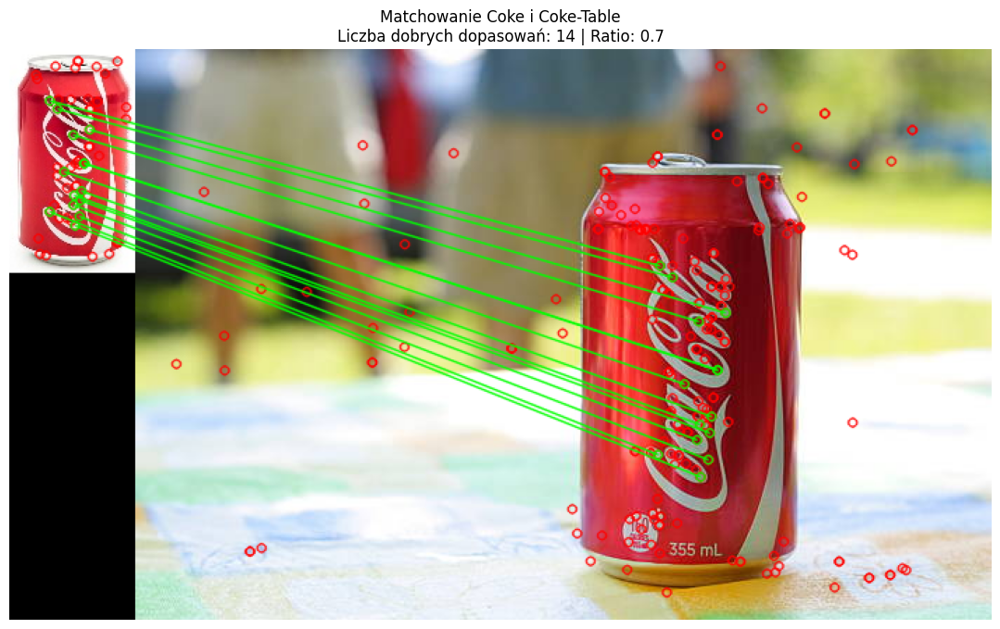

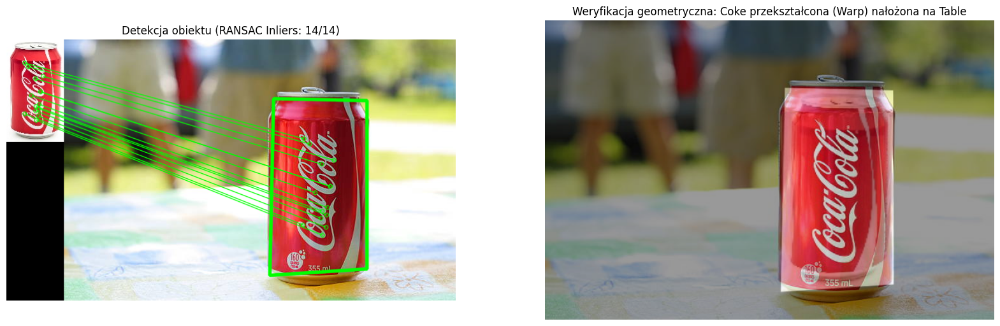

In [34]:
kp_c, kp_t, good_matches = match_and_analyze_sift(
    coke_crop,
    table,
    sift_params={"contrastThreshold": 0.04, "edgeThreshold": 5},
    title="Matchowanie Coke i Coke-Table",
    ratio_thresh=0.7,
    knn=2,
    visualize=True,
)
locate_object_with_homography(coke_crop, table, kp_c, kp_t, good_matches, method=0)